# DM-44234: run WEP on simulated lsstComCam data

* Last verified to run: **2024/09/25**

* Versions:

  * lsst_distrib:  **w_2024_32**
  * ts_wep: **v11.4.1**

As part of https://rubinobs.atlassian.net/browse/DM-41679   LsstComCam data was simulated pointing at two different sky regions

The repo is at `/sdf/data/rubin/shared/scichris/DM-41679_lsstComCam/gen3repo_1e9` 

Available visits are 
* 68661, with seqNums 940,941,942, and
* 68659, with seqNums 950,951,952



We perform the analysis below for the first visit: 68661.  

First, run just ISR, including variance. For completeness, all tasks are run inline on RSP notebook. 

In [20]:
from lsst.ts.wep.utils import getConfigDir as getWepConfigDir
def writeWepConfigurationIsrOnly(instName, pipelineYamlPath,butlerInstName):
        """Write wavefront estimation pipeline task configuration.

        Parameters
        ----------
        instName : str
            Name of the instrument this configuration is intended for.
        pipelineYamlPath : str
            Path where the pipeline task configuration yaml file
            should be saved.
        filterTypeName : str
            Filter type name: ref (or ''), u, g, r, i, z, or y.
        """

        with open(pipelineYamlPath, "w") as fp:
            fp.write(
                f"""# This yaml file is used to define the tasks and configuration of
# a Gen 3 pipeline used for testing
description: basic processing pipeline with imsim
# Here we specify the corresponding instrument for the data we
# will be using.
instrument: lsst.obs.lsst.Lsst{butlerInstName}
# Use imported instrument configuration
#imports:
#  - location: {getWepConfigDir()}/cwfs/instData/{instName}/instParamPipeConfig.yaml
# Then we can specify each task in our pipeline by a name
# and then specify the class name corresponding to that task
tasks:
  isr:
    class: lsst.ip.isr.isrTask.IsrTask
    # Below we specify the configuration settings we want to use
    # when running the task in this pipeline. Since our data doesn't
    # include bias or flats we only want to use doApplyGains and
    # doOverscan in our isr task.
    config:
      connections.outputExposure: 'postISRCCD'
      doBias: False
      doVariance: True
      doLinearize: False
      doCrosstalk: False
      doDefect: False
      doNanMasking: False
      doInterpolate: False
      doBrighterFatter: False
      doDark: False
      doFlat: False
      doApplyGains: True
      doFringe: False
      doOverscan: True
      python: OverscanCorrectionTask.ConfigClass.fitType = 'MEDIAN'
"""
            )
instName = 'comcam' 
path_cwd = '/sdf/data/rubin/shared/scichris/DM-41679_lsstComCam/'
pipelineYamlPath = os.path.join(path_cwd, "lsstPipelineISRdoVariance.yaml")
print(pipelineYamlPath)
butlerInstName = 'ComCam'
writeWepConfigurationIsrOnly(instName, pipelineYamlPath, butlerInstName)   

/sdf/data/rubin/shared/scichris/DM-41679_lsstComCam/lsstPipelineISRdoVariance.yaml


In [17]:
isrCollection = 'runISR_w2024_32_var'
numPro=5
day_obs = 20250820
f=9
print('\n')
bname = f'gen3repo_1e{f}'
butlerRootPath = os.path.join(path_cwd, bname)
cmd = f"pipetask run -b {butlerRootPath} "\
      f"-i LSST{butlerInstName}/raw/all,LSST{butlerInstName}/calib/unbounded "\
      f"--instrument lsst.obs.lsst.Lsst{butlerInstName} "\
      f"--register-dataset-types --output-run {isrCollection}  -p {pipelineYamlPath} -d "\
      f'"exposure.day_obs={day_obs}" -j {numPro}'

print(cmd)
runProgram(cmd)



pipetask run -b /sdf/data/rubin/shared/scichris/DM-41679_lsstComCam/gen3repo_1e9 -i LSSTComCam/raw/all,LSSTComCam/calib/unbounded --instrument lsst.obs.lsst.LsstComCam --register-dataset-types --output-run runISR_w2024_32_var  -p /sdf/data/rubin/shared/scichris/DM-41679_lsstComCam/lsstPipelineWEP_wcs_SN.yaml -d "exposure.day_obs=20250820" -j 5


Now write WEP configuration, using WCS-based donut catalog, and SN selection:

In [14]:
from lsst.ts.wep.utils import getConfigDir as getWepConfigDir
def writeWepConfigurationWepOnly(instName, pipelineYamlPath,butlerInstName):
        """Write wavefront estimation pipeline task configuration.

        Parameters
        ----------
        instName : str
            Name of the instrument this configuration is intended for.
        pipelineYamlPath : str
            Path where the pipeline task configuration yaml file
            should be saved.
        filterTypeName : str
            Filter type name: ref (or ''), u, g, r, i, z, or y.
        """

        

        with open(pipelineYamlPath, "w") as fp:
            fp.write(
                f"""# This yaml file is used to define the tasks and configuration of
# a Gen 3 pipeline used for testing
description: basic processing pipeline with imsim
# Here we specify the corresponding instrument for the data we
# will be using.
instrument: lsst.obs.lsst.Lsst{butlerInstName}
# Then we can specify each task in our pipeline by a name
# and then specify the class name corresponding to that task
tasks:
  generateDonutCatalogWcsTask:
    class: lsst.ts.wep.task.generateDonutCatalogWcsTask.GenerateDonutCatalogWcsTask
    config:
    # this config points to the GAIA DR2 refcat
      connections.refCatalogs: gaia_dr2_20200414
      anyFilterMapsToThis: phot_g_mean
      donutSelector.useCustomMagLimit: True
      donutSelector.magMax: 15.0
      donutSelector.magMin: 8.0
      donutSelector.unblendedSeparation: 160
  cutOutDonutsScienceSensorTask: 
    class: lsst.ts.wep.task.cutOutDonutsScienceSensorTask.CutOutDonutsScienceSensorTask
    config:
      maxRecenterDistance: 35
  calcZernikesTask:
    class: lsst.ts.wep.task.calcZernikesTask.CalcZernikesTask
    config:
      doDonutStampSelector: True
      donutStampSelector.selectWithEntropy: False
      donutStampSelector.selectWithSignalToNoise: True

    """)
    
    
instName = 'comcam'
path_cwd = '/sdf/data/rubin/shared/scichris/DM-41679_lsstComCam/'
pipelineYamlPath = os.path.join(path_cwd, "lsstPipelineWEP_wcs_SN.yaml")
butlerInstName='ComCam'
writeWepConfigurationWepOnly(instName, pipelineYamlPath,butlerInstName)   

In [18]:
from lsst.ts.wep.utils import  runProgram

numPro=10
path_cwd = '/sdf/data/rubin/shared/scichris/DM-41679_lsstComCam/'
butlerRootPath = os.path.join(path_cwd, 'gen3repo_1e9')
outputCollection = 'wep_wcs_w2024_32_variance_sn'
cmd = f"pipetask run -b {butlerRootPath} "+\
            f"-i refcats/gaia_dr2_20200414,{isrCollection},LSST{butlerInstName}/calib/unbounded "+\
            f"--instrument lsst.obs.lsst.Lsst{butlerInstName} "+\
            f"--register-dataset-types --output-run {outputCollection}   -p {pipelineYamlPath} -d "+\
           f'"exposure.seq_num in (940,942)" -j {numPro}'
print(cmd)
runProgram(cmd)

pipetask run -b /sdf/data/rubin/shared/scichris/DM-41679_lsstComCam/gen3repo_1e9 -i refcats/gaia_dr2_20200414,runISR_w2024_32_var,LSSTComCam/calib/unbounded --instrument lsst.obs.lsst.LsstComCam --register-dataset-types --output-run wep_wcs_w2024_32_variance_sn   -p /sdf/data/rubin/shared/scichris/DM-41679_lsstComCam/lsstPipelineWEP_wcs_SN.yaml -d "exposure.seq_num in (940,942)" -j 10


lsst.pipe.base.quantum_graph_builder INFO: Processing pipeline subgraph 1 of 1 with 3 task(s).
lsst.pipe.base.quantum_graph_builder INFO: Iterating over query results to associate quanta with datasets.
lsst.pipe.base.quantum_graph_builder INFO: Initial bipartite graph has 45 quanta, 240 dataset nodes, and 306 edges from 18 query row(s).
lsst.pipe.base.quantum_graph_builder INFO: Generated 18 quanta for task generateDonutCatalogWcsTask.
lsst.pipe.base.quantum_graph_builder INFO: Generated 9 quanta for task cutOutDonutsScienceSensorTask.
lsst.pipe.base.quantum_graph_builder INFO: Generated 18 quanta for task calcZernikesTask.
lsst.ctrl.mpexec.cmdLineFwk INFO: QuantumGraph contains 45 quanta for 3 tasks, graph ID: '1727302135.6751854-3224'
Quanta             Tasks            
------ -----------------------------
    18   generateDonutCatalogWcsTask
     9 cutOutDonutsScienceSensorTask
    18              calcZernikesTask
lsst.ctrl.mpexec.singleQuantumExecutor INFO: Preparing execution of 

Show the donuts: 

In [110]:
butlerRootPath = os.path.join(path_cwd, bname)
butler = dafButler.Butler(butlerRootPath)
registry = butler.registry
registry.queryDatasetTypes()

[DatasetType('camera', {instrument}, Camera, isCalibration=True),
 DatasetType('raw', {band, instrument, detector, physical_filter, exposure}, Exposure),
 DatasetType('packages', {}, Packages),
 DatasetType('isr_config', {}, Config),
 DatasetType('postISRCCD', {band, instrument, detector, physical_filter, exposure}, Exposure),
 DatasetType('isr_metadata', {band, instrument, detector, physical_filter, exposure}, TaskMetadata),
 DatasetType('isr_log', {band, instrument, detector, physical_filter, exposure}, ButlerLogRecords),
 DatasetType('gaia_dr2_20200414', {htm7}, SimpleCatalog),
 DatasetType('cutOutDonutsScienceSensorTask_config', {}, Config),
 DatasetType('calcZernikesTask_config', {}, Config),
 DatasetType('generateDonutCatalogWcsTask_config', {}, Config),
 DatasetType('donutCatalog', {band, instrument, detector, physical_filter, visit}, DataFrame),
 DatasetType('donutStampsExtra', {band, instrument, detector, physical_filter, visit}, StampsBase),
 DatasetType('donutStampsIntra', {

In [111]:
dataRefs = registry.queryDatasets('donutCatalog',collections=[outputCollection],
              where=f"instrument='LSST{butlerInstName}' and visit.day_obs={day_obs}").expanded()

In [112]:
for ref in dataRefs:
    print(ref)

donutCatalog@{instrument: 'LSSTComCam', detector: 0, visit: 5025082000940, band: 'g', physical_filter: 'g_01'} [sc=DataFrame] (run=wep_wcs_w2024_32_variance id=c2727710-2afc-49f4-aa0e-b777706bfd54)
donutCatalog@{instrument: 'LSSTComCam', detector: 0, visit: 5025082000942, band: 'g', physical_filter: 'g_01'} [sc=DataFrame] (run=wep_wcs_w2024_32_variance id=ba5d1ebf-f528-4501-940a-701de2738205)
donutCatalog@{instrument: 'LSSTComCam', detector: 1, visit: 5025082000940, band: 'g', physical_filter: 'g_01'} [sc=DataFrame] (run=wep_wcs_w2024_32_variance id=0b7abc0d-f908-4711-bb68-dba938e854ec)
donutCatalog@{instrument: 'LSSTComCam', detector: 1, visit: 5025082000942, band: 'g', physical_filter: 'g_01'} [sc=DataFrame] (run=wep_wcs_w2024_32_variance id=17720740-d656-42a9-a378-f65b1bc474bf)
donutCatalog@{instrument: 'LSSTComCam', detector: 2, visit: 5025082000940, band: 'g', physical_filter: 'g_01'} [sc=DataFrame] (run=wep_wcs_w2024_32_variance id=20cd5c50-d24f-4357-8e38-de8b96b22abb)
donutCatal

In [19]:
dataIdExtra = {'instrument': 'LSSTComCam', 'detector': 0, 'visit': 5025082000942}

In [20]:
donutCatalog =  butler.get('donutCatalog', dataId=dataIdExtra, collections=[outputCollection])

In [21]:
donutCatalog

,coord_ra,coord_dec,centroid_x,centroid_y,source_flux,blend_centroid_x,blend_centroid_y,detector
0,5.150740,-1.425733,2779.771624,435.171385,3.656261e+08,[],[],R22_S00
1,5.158695,-1.425886,1600.366221,251.507246,7.741667e+07,[],[],R22_S00
2,5.152073,-1.424756,2560.839062,1437.061944,7.111026e+07,[],[],R22_S00
3,5.163743,-1.423372,767.392689,2816.618647,5.813245e+07,[],[],R22_S00
4,5.151899,-1.425418,2600.715160,755.903759,3.054624e+07,[],[],R22_S00
5,5.160243,-1.423044,1286.767207,3170.394912,2.747574e+07,[],[],R22_S00
6,5.144335,-1.423022,3697.947070,3241.821830,1.601278e+07,[],[],R22_S00
7,5.149291,-1.423995,2963.943785,2228.406224,1.277682e+07,[],[],R22_S00
8,5.162085,-1.425452,1083.029183,683.573337,1.265085e+07,[],[],R22_S00
9,5.162006,-1.423860,1045.123286,2323.118730,8.518303e+06,[],[],R22_S00


Both intra and extra focal stamps are stored under extra-focal dataId:

In [25]:
donutStampsExtra = butler.get('donutStampsExtra' , dataId=dataIdExtra, collections=[outputCollection],)
donutStampsIntra = butler.get('donutStampsIntra' , dataId=dataIdExtra, collections=[outputCollection],)

In [117]:
len(donutStampsExtra)

16

In [118]:
len(donutStampsIntra)

16

Which ones got selected for Zk estimation:

In [26]:
donutsIntraQuality = butler.get('donutsIntraQuality' , dataId=dataIdExtra, collections=[outputCollection],)
donutsExtraQuality = butler.get('donutsExtraQuality' , dataId=dataIdExtra, collections=[outputCollection],)

In [23]:
donutsIntraQuality

,SN,ENTROPY,SN_SELECT,ENTROPY_SELECT,FINAL_SELECT
0,-12.927610,4.470123,False,True,False
1,5724.776367,1.642153,True,True,True
2,5709.623047,1.834195,True,True,True
3,4101.142090,2.280516,True,True,True
4,2670.449707,2.832920,True,True,True
5,1917.343628,3.341693,True,True,True
6,2307.596680,2.997099,True,True,True
7,1664.878174,3.505756,True,True,True
8,1904.179810,3.353516,True,True,True
9,1235.872559,3.877392,True,True,True


We can show which donuts got selected, also plotting their magnitude. The following properties are available in `stampsMetadata` per donut:

In [125]:
np.array(list(donutStampsExtra.metadata))

array(['SIMPLE', 'BITPIX', 'NAXIS', 'EXTEND', 'COMMENT', 'RA_DEG',
       'DEC_DEG', 'DET_NAME', 'CAM_NAME', 'VISIT', 'DFC_TYPE', 'DFC_DIST',
       'MAG', 'CENT_X0', 'CENT_Y0', 'CENT_X', 'CENT_Y', 'CENT_DX',
       'CENT_DY', 'CENT_DR', 'BLEND_CX', 'BLEND_CY', 'X0', 'Y0', 'SN',
       'SIGNAL_MEAN', 'SIGNAL_SUM', 'NPX_MASK', 'BKGD_STDEV',
       'SQRT_MEAN_VAR', 'BKGD_VAR', 'BACKGROUND_IMAGE_MEAN',
       'NOISE_VAR_BKGD', 'NOISE_VAR_DONUT', 'EFFECTIVE', 'ENTROPY',
       'PEAK_HEIGHT', 'BANDPASS', 'HAS_MASK', 'HAS_VARIANCE',
       'HAS_ARCHIVE', 'N_STAMPS', 'STAMPCLS', 'VERSION', 'ARCHIVE_IDS'],
      dtype='<U21')

We can read either with `getArray` method:

In [126]:
mag = donutStampsExtra.metadata.getArray('MAG')

In [53]:
# The SN thresholds are stored in `snLimitStar` file; 
# code below is used eg. by https://github.com/lsst-ts/ts_wep/blob/develop/python/lsst/ts/wep/task/donutStampSelectorTask.py 
from lsst.ts.wep.utils import readConfigYaml
from lsst.ts.wep.task.donutStampSelectorTask import DonutStampSelectorTaskConfig

# get the SN from the yaml
snPolicyDefaults = readConfigYaml("policy:snLimitStar.yaml")
filterName = donutStampsExtra[0].bandpass
filterKey = f"filter{filterName.upper()}"
minSn = snPolicyDefaults[filterKey]

# get the entropy from task config 
config = DonutStampSelectorTaskConfig()
maxEntropy = config.maxEntropy

Text(0.5, 0.98, 'Extra-focal')

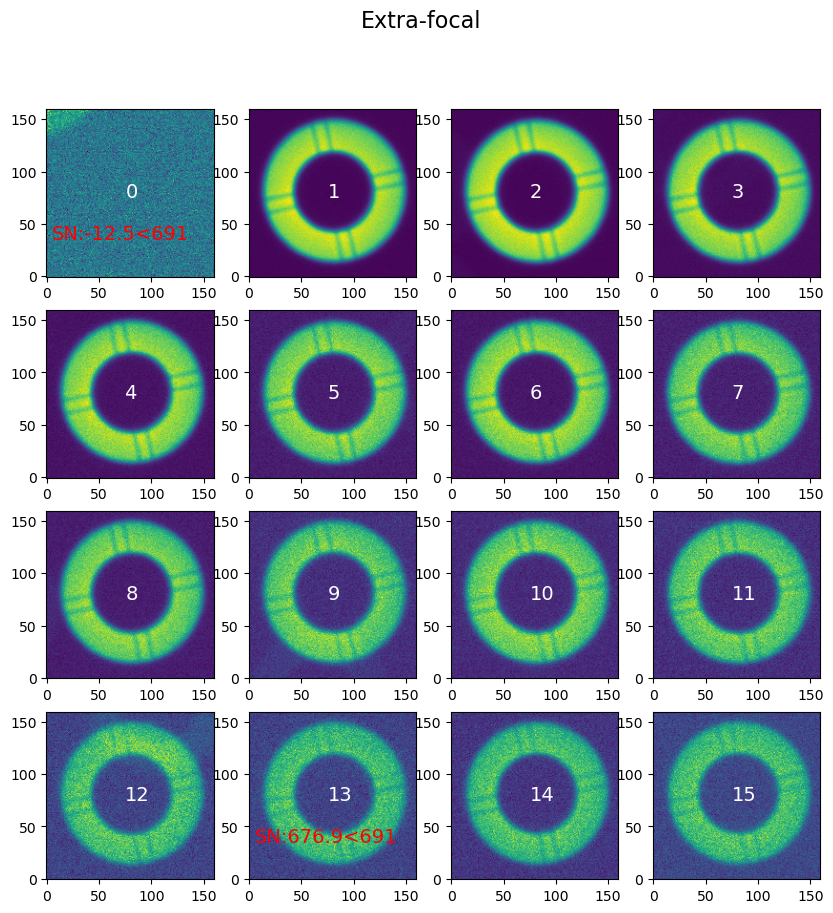

In [19]:
import matplotlib.pyplot as plt 
import numpy as np 

fig,axs = plt.subplots(4,4,figsize=(10,10))
ax = np.ravel(axs)
Nstamps = len(donutStampsExtra)

for i in range(Nstamps):
    ax[i].imshow(donutStampsExtra[i].stamp_im.image.array, origin='lower')
    ax[i].text(75,75,i, fontsize=14, color='white')
    if not donutsExtraQuality['SN_SELECT'][i]:
       sn = donutsExtraQuality['SN'][i]
       
       ax[i].text(5,35,f'SN:{sn:.1f}<{minSn}', fontsize=14, color='red')
    if not donutsExtraQuality['ENTROPY_SELECT'][i]:
       entro = donutsExtraQuality['ENTROPY'][i]
       ax[i].text(5,15,f'entropy:{entro:.1f}>{maxEntropy}', fontsize=14, color='red')
    
fig.suptitle('Extra-focal', fontsize=16)

Show other detectors and which donuts were selected (or not selected):

In [48]:
import lsst.daf.butler as dafButler
import os 

path_cwd = '/sdf/data/rubin/shared/scichris/DM-41679_lsstComCam/'
butlerRootPath = os.path.join(path_cwd, 'gen3repo_1e9')
butler = dafButler.Butler(butlerRootPath)
outputCollection = 'wep_wcs_w2024_32_variance_sn'

detector_data = {}
for detId in range(9):
    dataIdExtra = {'instrument': 'LSSTComCam', 'detector': detId, 'visit': 5025082000942}
    donutStampsExtra = butler.get('donutStampsExtra' , dataId=dataIdExtra, collections=[outputCollection],)
    donutStampsIntra = butler.get('donutStampsIntra' , dataId=dataIdExtra, collections=[outputCollection],)
    
    donutsIntraQuality = butler.get('donutsIntraQuality' , dataId=dataIdExtra, collections=[outputCollection],)
    donutsExtraQuality = butler.get('donutsExtraQuality' , dataId=dataIdExtra, collections=[outputCollection],)
    
    # exposures are keyed with exposure rather than visit 
    dataIdExtra = {'instrument': 'LSSTComCam', 'detector': detId, 'exposure': 5025082000942}
    dataIdIntra = {'instrument': 'LSSTComCam', 'detector': detId, 'exposure': 5025082000940}
    isrCollection = 'runISR_w2024_32_var'
    exposureExtra = butler.get('postISRCCD',  dataId=dataIdExtra, collections=[isrCollection])
    exposureIntra = butler.get('postISRCCD',  dataId=dataIdIntra, collections=[isrCollection])

    detector_data[detId] = {'donutStampsExtra':donutStampsExtra,
                            'donutStampsIntra':donutStampsIntra,
                            'donutsIntraQuality':donutsIntraQuality,
                            'donutsExtraQuality':donutsExtraQuality,
                            'exposureExtra':exposureExtra,
                            'exposureIntra':exposureIntra
                            }

In [50]:
import matplotlib.pyplot as plt 
from astropy.visualization import ZScaleInterval

def plot_donut_locations(
    exposure,
    donut_stamps,
    ax=None,
    fig=None,
    left=0.6,
    bottom=0.5,
    height=0.6,
    noxticks=True,
    noxlabel=True,
    maketitle=False,
    title=None
):
    """Plot the donut locations on the postISR image.

    Parameters
    ----------
    exposure: lsst.afw.image.Exposure
        Exposure (postISR) with the donut images.
    donut_stamps: Collection of postage stamps as
        lsst.afw.image.maskedImage.MaskedImage.
        with additional metadata.
    ax: axis for plotting, if None it is added to the figure.
    fig: figure for plotting , if None a new figure is made.
    """
    if fig is None:
        fig = plt.figure()

    if ax is None:
        ax = fig.add_axes([left, bottom, 0.4, height])  # left, bottom, width,  height

    data = exposure.image.array
    zscale = ZScaleInterval()
    vmin, vmax = zscale.get_limits(data)

    ax.imshow(data, origin="lower", vmin=vmin, vmax=vmax)

    nrows = len(donut_stamps)
    for i in range(nrows):
        donut = donut_stamps[i]
        xy = donut.centroid_position

        # plot the cross marking that the donut was used
        ax.scatter(xy[0], xy[1], s=200, marker="+", c="m", lw=1)

        # plot the donut number on the plot
        xtext, ytext = xy[0], xy[1]
        ytext -= 60
        if xtext + 100 > 4096:
            xtext -= 250
        if len(str(i)) > 1:  # move to the left label that is too long
            xtext -= 340
        else:
            xtext -= 260
        ax.text(xtext, ytext, f"{i}", fontsize=17, c="white")
    ax.yaxis.tick_right()
    if not noxlabel:
        ax.set_xlabel("x [px]")
    ax.set_ylabel("y [px]")
    if noxticks:
        ax.set_xticklabels("")
    ax.yaxis.set_label_position("right")
    info = exposure.getMetadata()
    title = ''
    if maketitle:
        title = f"exposure {info['OBSID']}, det{exposure.detector.getId()} ({exposure.detector.getName()})"

    ax.set_title(title)
    return


In [55]:
def plot_donut_stamps_quality(donut_stamps, donut_quality, minSn, maxEntropy, text=""):
    """Plot the donut stamp image cutouts.

    Parameters
    ----------
    donut_stamps: Collection of postage stamps as
        lsst.afw.image.maskedImage.MaskedImage.
        with additional metadata.
    """
    # calculate number of rows given
    # the constraint of the number of
    # columns
    n_donuts = len(donut_stamps)
    ncols = 6
    nrows = n_donuts // ncols
    if nrows * ncols < n_donuts:
        nrows += 1

    fig, axs = plt.subplots(nrows, ncols, figsize=(3 * ncols, 3 * nrows))
    ax = np.ravel(axs)
    for i in range(n_donuts):
        donut = donut_stamps[i]
        ax[i].imshow(donut.stamp_im.image.array, origin="lower")
        ax[i].text(80, 80, f"{i}", fontsize=17, c="white")


        if not donut_quality['SN_SELECT'][i]:
           sn = donut_quality['SN'][i]
           
           ax[i].text(5,35,f'SN:{sn:.1f}<{minSn}', fontsize=14, color='red')
        if not donut_quality['ENTROPY_SELECT'][i]:
           entro = donut_quality['ENTROPY'][i]
           ax[i].text(5,15,f'entropy:{entro:.1f}>{maxEntropy}', fontsize=14, color='red')
            
    fig.subplots_adjust(hspace=0.35)

    # if there are more axes than donuts,
    # turn off the extra axes
    ncells = nrows * ncols
    if ncells > n_donuts:
        for axis in ax[n_donuts:]:
            axis.axis("off")
    ax[0].set_title(text)
    return

At least based on this simulation, it looks like a good entropy threshold between good donuts vs  those with background blended in would be ~4.4 . But for now, lets use only SN selection, not entropy. 





# Plot the fit Zk and the opd 

In [60]:
from astropy.io import fits
opd_fpath = '/sdf/data/rubin/shared/scichris/DM-41679_lsstComCam/output-max-flux-1e9/00068661/opd_0.0.fits.fz'
hdul = fits.open(opd_fpath)


opds = {}
for i in range(len(hdul)):
    opd_zks_1_28 = []
    for key,value in hdul[i].header.items():
        
        if key.startswith('AZ'):
            #print(key.split('_')[1])
            opd_zks_1_28.append(value)
    opds[i] = opd_zks_1_28
    

In [61]:
def plot_raw_zernikes(
    output_zernikes_raw=None,
    ax=None,
    fig=None,
    title="",
    output_zernikes_averaged=None,
    bbox_to_anchor=[0.55, 0.65],
    legendfontsize=12,
    opd=None,
    maxNoll = 28
):
    """Plot the raw Zernike coefficients.

    Parameters
    ----------
    output_zernikes_raw: numpy.ndarray
       Zernike fit coefficients for the donuts.
    ax: axis for plotting, if None it is added to the figure
    fig: figure for plotting
    """
    if fig is None:
        fig = plt.figure()

    if ax is None:
        ax = fig.add_axes([0, 0, 0.6, 1])
    if output_zernikes_raw is not None:
        for i in range(len(output_zernikes_raw)):
    
            ax.plot(
                np.arange(4, maxNoll+1),
                1000 * output_zernikes_raw[i],
                "--s",
                alpha=0.4,
                label=f"donut {i}",
            )
    if output_zernikes_averaged is not None:
        ax.plot(
            np.arange(4, maxNoll+1), 1000 * output_zernikes_averaged, "-d", label="average",
            c='orange', lw=3
        )
    if opd is not None:
        ax.plot(np.arange(4, maxNoll+1), opd, "-o", label="opd", c="red", alpha=1)
    ax.set_xlabel(
        "Zernike polynomials mode",
    )
    ax.set_ylabel(
        "Zernike Coefficient [nanometers]",
    )
    ax.legend(
        fontsize=legendfontsize,
        loc="center left",
        bbox_to_anchor=bbox_to_anchor,
        ncol=2,
    )
    ax.set_xticks(np.arange(4, maxNoll)[::2])
    ax.grid()

    ax.set_title(title, fontsize=18)

    return

Plot just in-focus OPDs: there is a very small variation sensor to sensor:

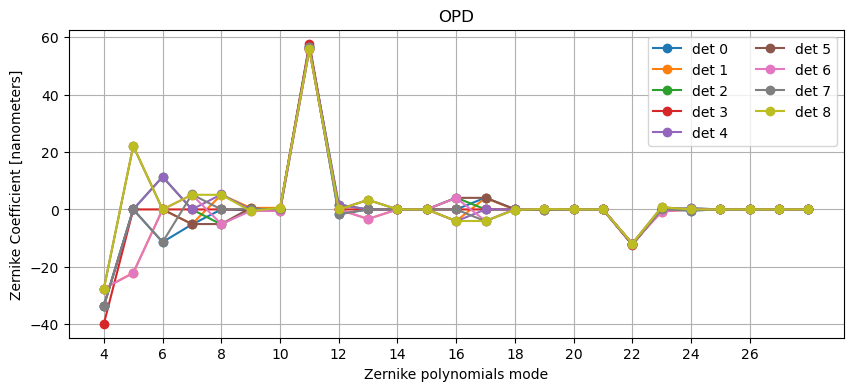

In [62]:

fig,ax  = plt.subplots(1,1,figsize=(10,4))
for detNum in range(9):
    opd = opds[detNum+1][3:28]
    maxNoll=28
    ax.plot(np.arange(4, maxNoll+1), opd, "-o", label=f"det {detNum}", alpha=1)
ax.set_title('OPD')
ax.set_xticks(np.arange(4, maxNoll)[::2])
ax.grid()
ax.set_xlabel(
    "Zernike polynomials mode",
)
ax.set_ylabel(
    "Zernike Coefficient [nanometers]",
    )
plt.legend(loc="upper right",ncol=2)

With 9 CCDs, and two exposures, we have one set of Zk results per detector.  Show below the raw Zernikes, OPD values evaluated at the center of each detector, and the averaged Zernike values:



/tmp/ipykernel_3799/3656866704.py:2: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig = plt.figure(figsize=(10,4))


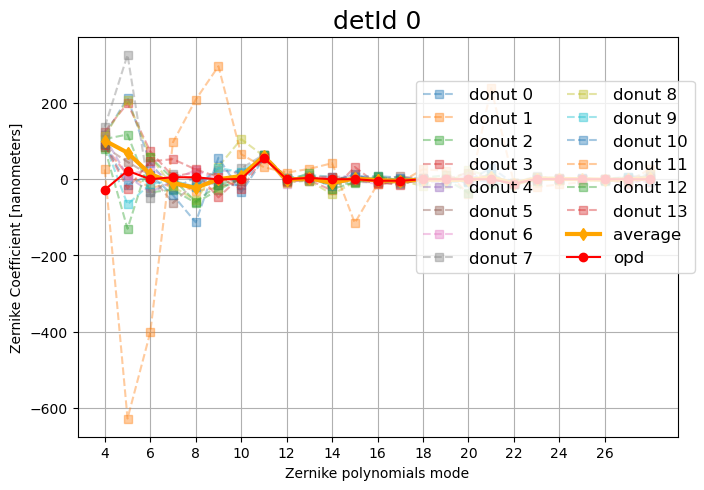

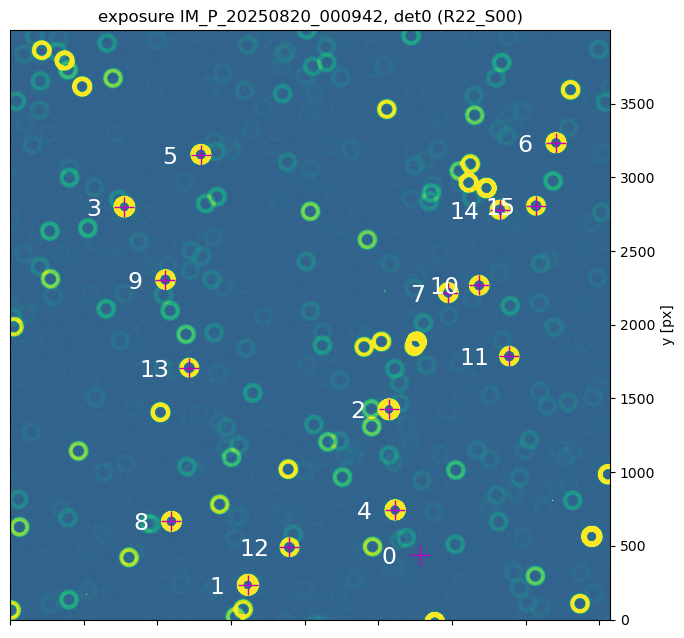

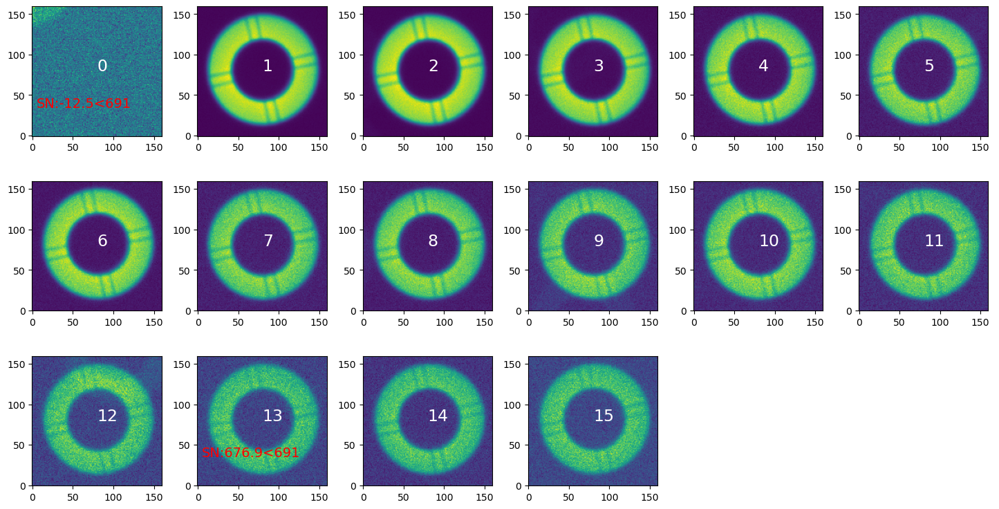

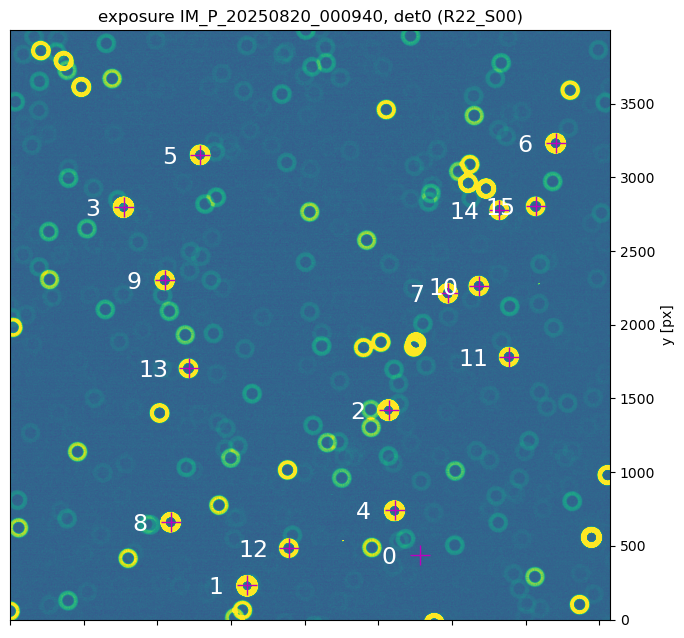

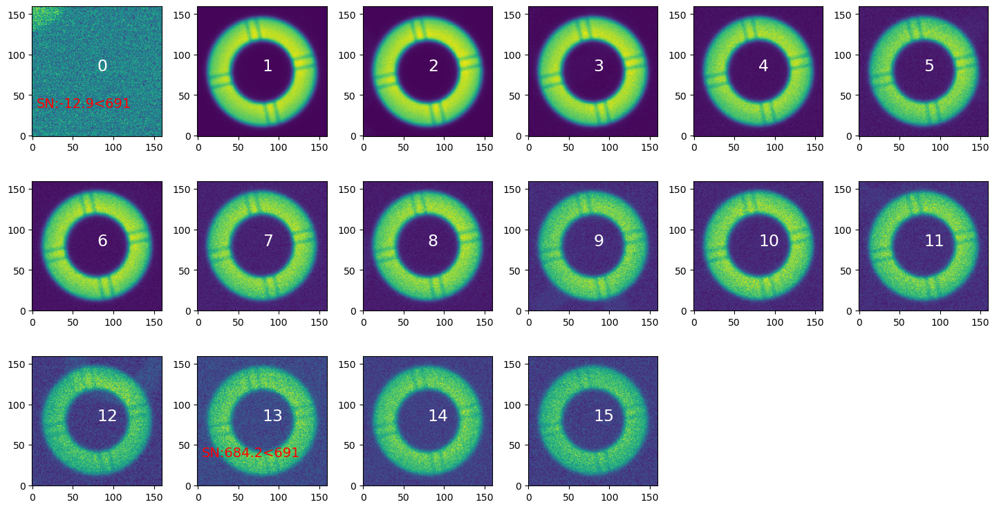

...

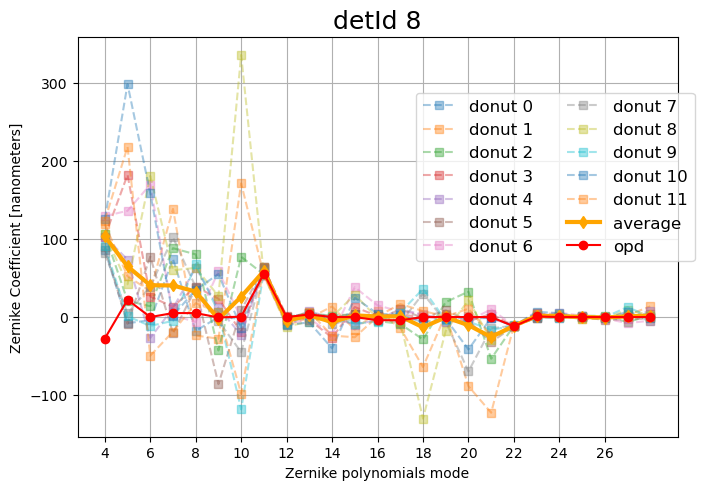

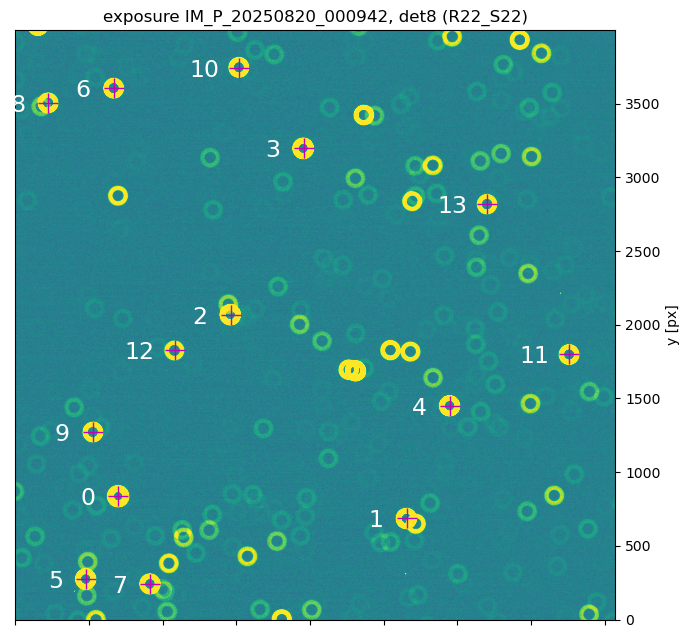

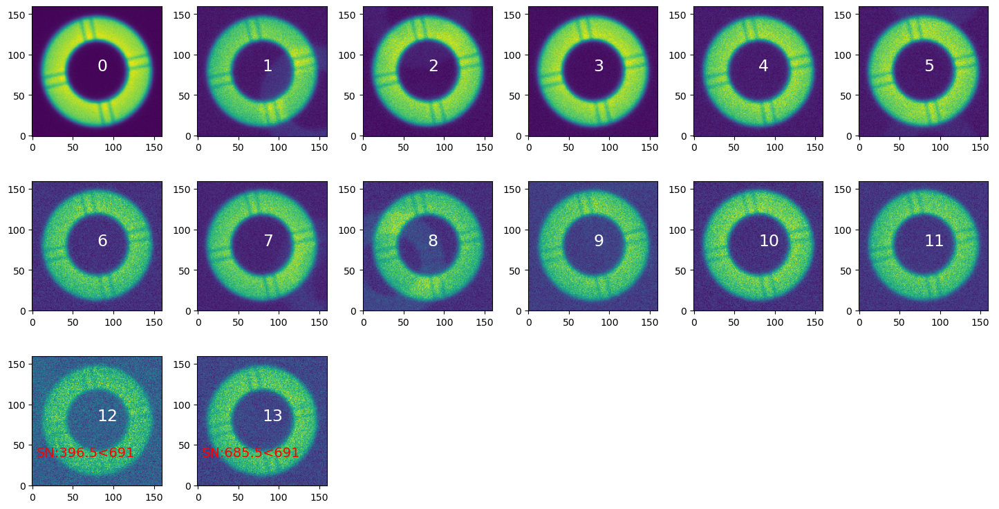

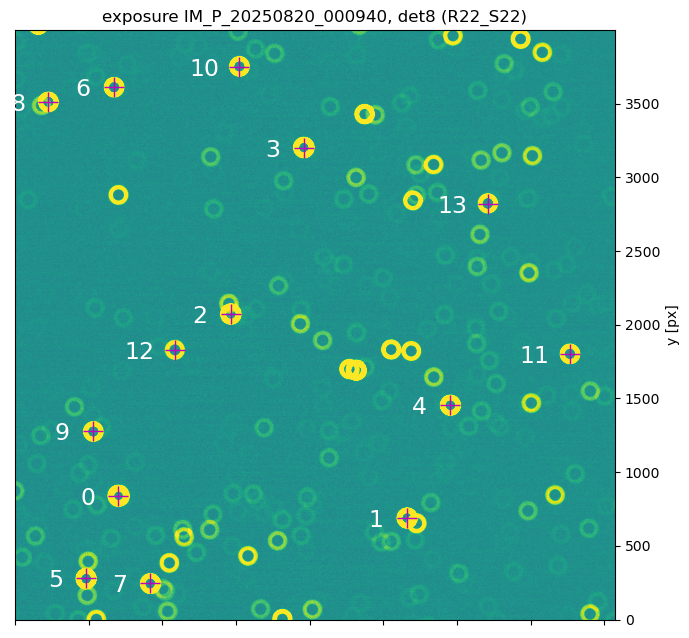

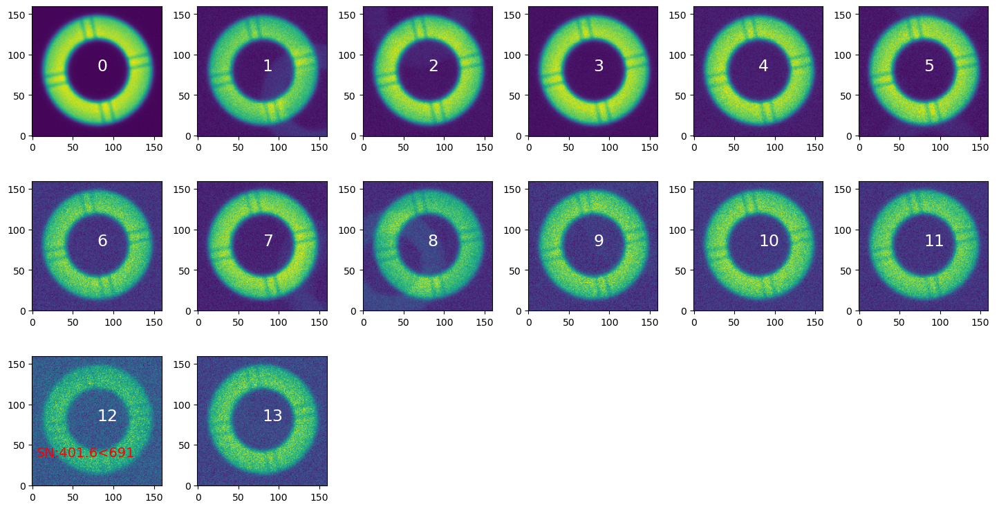

In [65]:

for detId in range(9):
    fig = plt.figure(figsize=(10,4))
    
    dataIdExtra = {'instrument': 'LSSTComCam', 'detector': detId, 'visit': 5025082000942}
    zkRaw = butler.get('zernikeEstimateRaw', dataId=dataIdExtra, collections=[outputCollection])
    zkAvg = butler.get('zernikeEstimateAvg', dataId = dataIdExtra,  collections=[outputCollection])

    plot_raw_zernikes(output_zernikes_raw =zkRaw, output_zernikes_averaged=zkAvg[0],
                      fig=fig, title=f'detId {detId}', opd=opds[detNum+1][3:28])


    for d in ['Ex','In']:

        plot_donut_locations(
             detector_data[detId][f'exposure{d}tra'], 
             detector_data[detId][f'donutStamps{d}tra'], fig= plt.figure(figsize=(15,15)),
             maketitle=True
        )
        plot_donut_stamps_quality(detector_data[detId][f'donutStamps{d}tra'], 
                                  detector_data[detId][f'donuts{d}traQuality'], 
                                  minSn, 
                                  maxEntropy, text="")
        
    
   

What I notice here that neither of these is actually close to the OPD (apart from Zk11). Why could that be? 

## Running calcZernikesTask interactively

We can also run the `calcZernikesTask` interactively to test different settings on the fly. For instance, we can turn off entropy selection:


In [108]:
from lsst.ts.wep.task.calcZernikesTask import (
    CalcZernikesTask,
    CalcZernikesTaskConfig,
)

butlerRootPath = os.path.join(path_cwd, bname)
butler = dafButler.Butler(butlerRootPath)
dataIdExtra = {'instrument': 'LSSTComCam', 'detector': 0, 'visit': 5025082000942}
donutStampsExtra = butler.get('donutStampsExtra' , dataId=dataIdExtra, collections=[outputCollection],)
donutStampsIntra = butler.get('donutStampsIntra' , dataId=dataIdExtra, collections=[outputCollection],)

In [109]:
config = CalcZernikesTaskConfig()
config.doDonutStampSelector = True
config.donutStampSelector.selectWithEntropy = False
config.donutStampSelector.selectWithSignalToNoise = True
calcTask = CalcZernikesTask(config=config, name="Selection with default params")
taskOut = calcTask.run(donutStampsExtra, donutStampsIntra)

INFO:lsst.Selection with default params:Running Donut Stamp Selector
INFO:lsst.Selection with default params.donutStampSelector:Selected 14/16 donut stamps
INFO:lsst.Selection with default params.donutStampSelector:Selected 14/16 donut stamps
INFO:CombineZernikesSigmaClipTask:MaxZernClip config: 3. MaxZernClip used: 3.
INFO:CombineZernikesSigmaClipTask:Using 13 pairs out of 14 in final Zernike estimate.
